<a href="https://colab.research.google.com/github/RudiksChess/UVG-DataScience-Proyecto2-/blob/main/AvancesProyecto2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1><center>Avances - Análisis Exploratorio - Proyecto 2 -  Data Science</center></h1>
<h2><center>Catedrático: Luis Furlan</center></h2>
<h3><center>Realizado por:</center></h3>
<h3><center>Augusto Alonso, Rudik Rompich, David Cuellar</center></h3>
<h3><center>Grupo #2</center></h3>

**Problema seleccionado:** Tarjetas de crédito. 

# Paquetes y visualización rápida

Paquetes importantes que se utilizarán: 

In [1]:
import pandas as pd 
import glob 
import numpy as np 
import matplotlib.pyplot as plt 
import numpy as np
import seaborn as sns

Para el problema de las tarjetas de crédito, será necesario investigar sobre las diferentes formas que hay para que el cliente pueda resolver el problema ante los emisores de tarjeta. 

Se comienza exportando los datos desde un repositorio en GitHub en donde se alojará todo el proyecto. 

In [2]:
df = pd.read_csv("https://raw.githubusercontent.com/RudiksChess/UVG-DataScience-Proyecto2-/main/UCI_Credit_Card.csv")

Para una visualización detallada y eficiente de la base de datos, se propone utilizar *PandasProfiler* (del cual instalamos su última versión para no tener ningún problema): 

In [3]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip (34.6 MB)


In [4]:
from pandas_profiling import ProfileReport

In [5]:
pandasReporte = ProfileReport(df, title="Resumen rápido de los datos", explorative=True) 
# Se coloca explorative=True para un análisis detallado de todos los datos que se utilizarán. 
pandasReporte.to_notebook_iframe()

Summarize dataset:   0%|          | 0/38 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Análisis exploratorio rudimentario 

In [6]:
df.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,1,20000.0,2,2,1,24,2,2,-1,-1,-2,-2,3913.0,3102.0,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,0,2,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,0,0,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,4,50000.0,2,2,1,37,0,0,0,0,0,0,46990.0,48233.0,49291.0,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,5,50000.0,1,2,1,57,-1,0,-1,0,0,0,8617.0,5670.0,35835.0,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


In [7]:
df.shape

(30000, 25)

In [8]:
df.isna().sum()

ID                            0
LIMIT_BAL                     0
SEX                           0
EDUCATION                     0
MARRIAGE                      0
AGE                           0
PAY_0                         0
PAY_2                         0
PAY_3                         0
PAY_4                         0
PAY_5                         0
PAY_6                         0
BILL_AMT1                     0
BILL_AMT2                     0
BILL_AMT3                     0
BILL_AMT4                     0
BILL_AMT5                     0
BILL_AMT6                     0
PAY_AMT1                      0
PAY_AMT2                      0
PAY_AMT3                      0
PAY_AMT4                      0
PAY_AMT5                      0
PAY_AMT6                      0
default.payment.next.month    0
dtype: int64

# Mapeos respecto a sus variables 

Tiene como utilidad hacer más leíble el dataframe. 

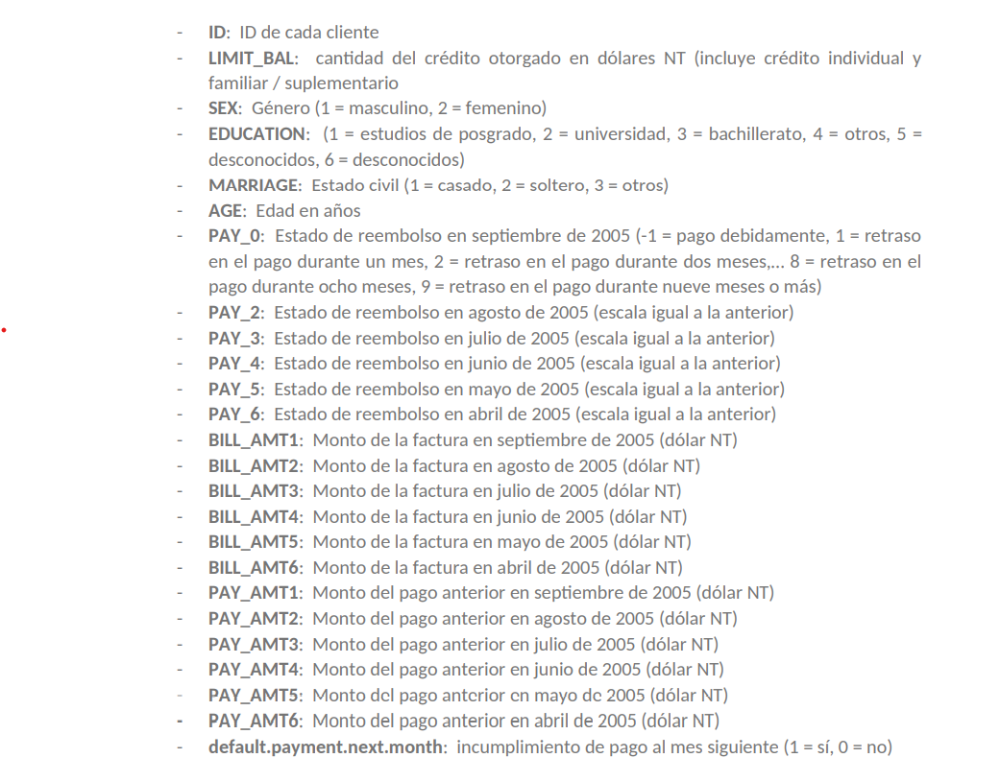

In [9]:
map_education = {1:"Postgrado",2:"Universidad",3:"Bachillerato",4:"Otros",5:"Desconocido 2",6:"Desconocidos 3",0:"Desconocido 1"}
map_sex = {1:"Masculino",2:"Femenino"}
map_marriage = {1:"Casado",2:"Soltero",3:"Otros"}
map_pays = {-1:"Solvente",0:"Solvente",-2:"Solvente",1:"Retraso 1-3 meses",2:"Retraso 1-3 meses",3:"Retraso 1-3 meses",4:"Retraso 4-6 meses",5:"Retraso 4-6 meses",
            6:"Retraso 4-6 meses",7:"Retraso 7+ meses",8:"Retraso 7+ meses",9:"Retraso 7+ meses"}

In [10]:
df["PAY_0"].unique()

array([ 2, -1,  0, -2,  1,  3,  4,  8,  7,  5,  6])

In [11]:
df["SEX"] = df["SEX"].map(map_sex)
df["EDUCATION"] = df["EDUCATION"].map(map_education)
df["MARRIAGE"] = df["MARRIAGE"].map(map_marriage)

In [12]:
df["PAY_0"] = df["PAY_0"].map(map_pays)
df["PAY_2"] = df["PAY_2"].map(map_pays)
df["PAY_3"] = df["PAY_3"].map(map_pays)
df["PAY_4"] = df["PAY_4"].map(map_pays)
df["PAY_5"] = df["PAY_5"].map(map_pays)
df["PAY_6"] = df["PAY_6"].map(map_pays)

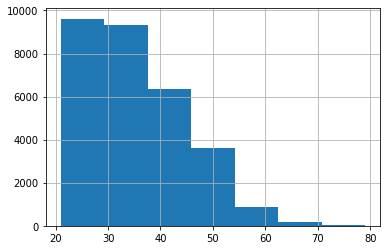

In [13]:
df["AGE"].hist(bins = 7)

In [14]:
df["AGE_LABEL"] = pd.cut(df["AGE"],bins = 6, labels=["Joven", "Adulto joven", "Adulto","Adulto Maduro","Edad Avanzada", "Mayor 70+"])

In [15]:
pd.cut(df["AGE"],bins = 6).unique()

[(20.942, 30.667], (30.667, 40.333], (50.0, 59.667], (40.333, 50.0], (59.667, 69.333], (69.333, 79.0]]
Categories (6, interval[float64]): [(20.942, 30.667] < (30.667, 40.333] < (40.333, 50.0] <
                                    (50.0, 59.667] < (59.667, 69.333] < (69.333, 79.0]]

# DF mapeado 

In [16]:
df.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month,AGE_LABEL
0,1,20000.0,Femenino,Universidad,Casado,24,Retraso 1-3 meses,Retraso 1-3 meses,Solvente,Solvente,Solvente,Solvente,3913.0,3102.0,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1,Joven
1,2,120000.0,Femenino,Universidad,Soltero,26,Solvente,Retraso 1-3 meses,Solvente,Solvente,Solvente,Retraso 1-3 meses,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1,Joven
2,3,90000.0,Femenino,Universidad,Soltero,34,Solvente,Solvente,Solvente,Solvente,Solvente,Solvente,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0,Adulto joven
3,4,50000.0,Femenino,Universidad,Casado,37,Solvente,Solvente,Solvente,Solvente,Solvente,Solvente,46990.0,48233.0,49291.0,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0,Adulto joven
4,5,50000.0,Masculino,Universidad,Casado,57,Solvente,Solvente,Solvente,Solvente,Solvente,Solvente,8617.0,5670.0,35835.0,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0,Adulto Maduro


In [17]:
df.columns

Index(['ID', 'LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0',
       'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6',
       'default.payment.next.month', 'AGE_LABEL'],
      dtype='object')

# Análisis específicos 

## Análisis

### Análisis de distribución de los préstamos



En la siguiente gráfica se puede observar que claramente los datos están sesgados hacia la derecha, los datos están acumulados aproximadamente entre 50 mil dólares y 230, además se puede notar que son raros los casos que presentan un cargo igual o superior al medio millón de dólares. Nótese que existen una serie de datos atípicos que serán necesarios eliminar en un análisis posterior para evitar que el modelo sea impreciso. 

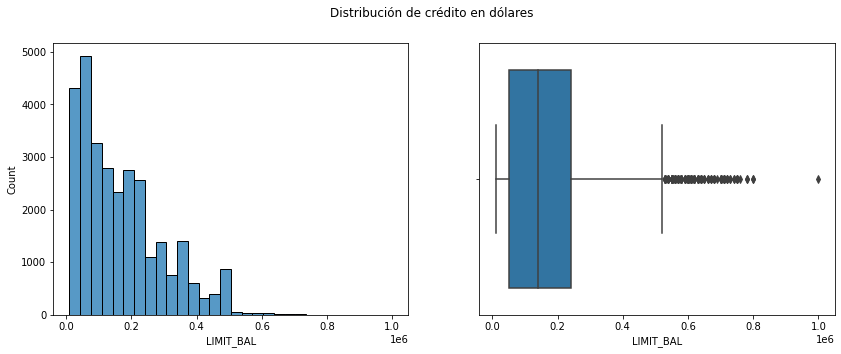

In [18]:
fig, axes = plt.subplots(1, 2, figsize=(14, 5))
fig.suptitle('Distribución de crédito en dólares')

sns.histplot(data= df, x="LIMIT_BAL", bins = 30, ax=axes[0])
sns.boxplot(data= df, x="LIMIT_BAL", ax=axes[1])

### Análisis por género

In [19]:
df[["SEX","LIMIT_BAL"]].groupby("SEX").agg(["mean","count","median"])

LIMIT_BAL                 
                    mean  count    median
SEX                                      
Femenino   170086.462014  18112  150000.0
Masculino  163519.825034  11888  130000.0

In [20]:
(18112 - 11888) / 18112

0.34363957597173145

En el dataframe de arriba se puede observar que las mujeres tienen una media y una mediana un poco más grande que los hombres, además de contar con un 34% más de datos.



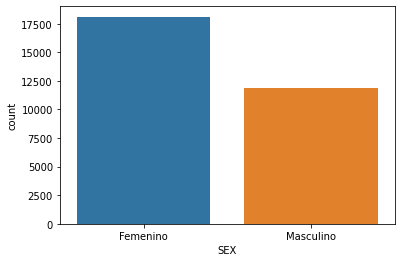

In [21]:
sns.countplot(x="SEX", data=df)

En la gráfica de abajo se puede observar que la distribución entre hombres y mujeres es bastante similar en cuanto a mediana, quartiles y outliers, solamente en los histogramas se puede observar que las mujeres tienen barras más elevadas dado que hay más datos de mujeres. Nótese que los **outliers** serán necesarios revisarlos; aunque a primera instancia, parecen que son normales y no afectarían directamente al modelo. 

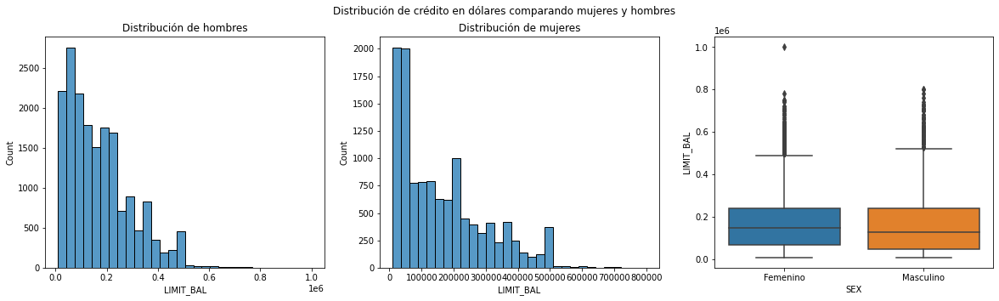

In [22]:
fig, axes = plt.subplots(1, 3, figsize=(20, 5))
fig.suptitle('Distribución de crédito en dólares comparando mujeres y hombres')

sns.histplot(data= df.loc[df["SEX"] == "Femenino"], x="LIMIT_BAL", bins = 30, ax=axes[0])
axes[0].set_title("Distribución de hombres")

sns.histplot(data= df.loc[df["SEX"] == "Masculino"], x="LIMIT_BAL", bins = 30, ax=axes[1])
axes[1].set_title("Distribución de mujeres")

sns.boxplot(data= df, x="SEX", y = "LIMIT_BAL", ax=axes[2])
# axes[2].set_title(bulbasaur.nam)

In [23]:
df.columns

Index(['ID', 'LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0',
       'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6',
       'default.payment.next.month', 'AGE_LABEL'],
      dtype='object')

### Análisis por educación


In [24]:
df[["EDUCATION","LIMIT_BAL"]].groupby("EDUCATION").agg(["mean","count","median"])

LIMIT_BAL                 
                         mean  count    median
EDUCATION                                     
Bachillerato    126550.270490   4917   80000.0
Desconocido 1   217142.857143     14  215000.0
Desconocido 2   168164.285714    280  150000.0
Desconocidos 3  148235.294118     51  100000.0
Otros           220894.308943    123  200000.0
Postgrado       212956.069910  10585  200000.0
Universidad     147062.437634  14030  110000.0

Los grupos más representativos con una gran diferencia en este conjunto de datos son aquellos que pertencen a aquellos individuos que tienen estudios de post grado, universidad y bachillerato. Por otro lado en la gráfica de abajo se puede observar que los individuos de bachillerato son los individuos que piden préstamos mucho más bajos que el resto y los individuos que tienen estudios de postgrado, pertencen al nivel de educación 0 y tienen otro grado de educación (Grupo 4), son los individuos que hacen préstamos más grandes.


In [25]:
mean_by_education = df[["EDUCATION","LIMIT_BAL"]].groupby("EDUCATION").agg("mean")
mean_by_education.reset_index(inplace = True)

median_by_education = df[["EDUCATION","LIMIT_BAL"]].groupby("EDUCATION").agg("median")
median_by_education.reset_index(inplace = True)

[Text(0, 0, 'Universidad'),
 Text(0, 0, 'Postgrado'),
 Text(0, 0, 'Bachillerato'),
 Text(0, 0, 'Desconocido 2'),
 Text(0, 0, 'Otros'),
 Text(0, 0, 'Desconocidos 3'),
 Text(0, 0, 'Desconocido 1')]

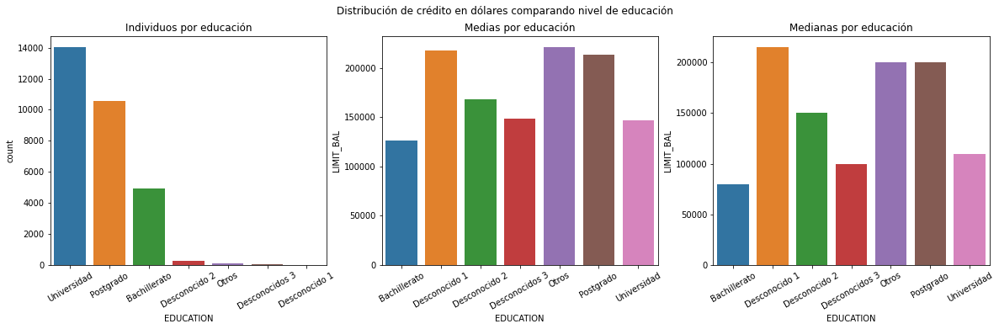

In [26]:
fig, axes = plt.subplots(1, 3, figsize=(20, 5))
fig.suptitle('Distribución de crédito en dólares comparando nivel de educación')

sns.barplot(x="EDUCATION", y="LIMIT_BAL", data=mean_by_education, ax = axes[1])
axes[1].set_title("Medias por educación")
axes[1].set_xticklabels(axes[1].get_xticklabels(),rotation = 30)

sns.barplot(x="EDUCATION", y="LIMIT_BAL", data=median_by_education, ax = axes[2])
axes[2].set_title("Medianas por educación")
axes[2].set_xticklabels(axes[2].get_xticklabels(),rotation = 30)

sns.countplot(x="EDUCATION", data=df, ax = axes[0])
axes[0].set_title("Individuos por educación")
axes[0].set_xticklabels(axes[0].get_xticklabels(),rotation = 30)

En la gráfica de abajo se puede confirmar las conclusiones del parráfo de arriba, es decir los individuos de Bachillerato son los que hacen préstamos más bajos pero tienen bastantes outliers y los individuos que tienen estudios en la universidad, postgrado o pertenecen al grupo desconocido 1 son los grupos que más gastan. Pero el grupo de desconocido 1 lo podemos descartar del análisis dado que tenemos muy pocos individuos en este grupo.


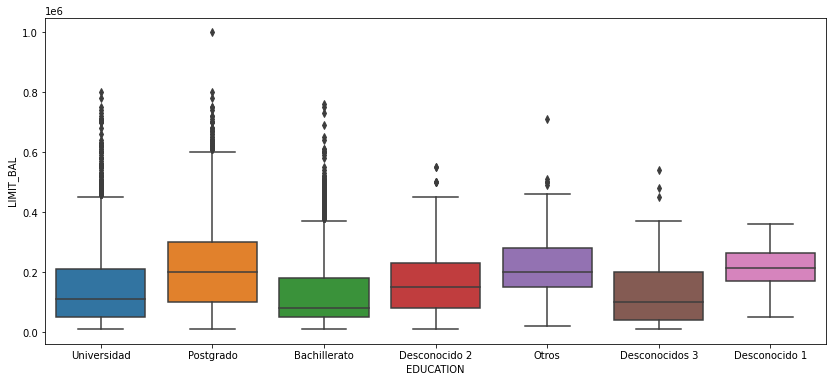

In [27]:
fig_dims = (14, 6)
fig, ax = plt.subplots(figsize=fig_dims)

sns.boxplot(data= df, x="EDUCATION", y = "LIMIT_BAL", ax = ax)

### Análisis por estado civil

In [28]:
df[["MARRIAGE","LIMIT_BAL"]].groupby("MARRIAGE").agg(["mean","count","median"])

LIMIT_BAL                 
                   mean  count    median
MARRIAGE                                
Casado    182200.893184  13659  160000.0
Otros      98080.495356    323   60000.0
Soltero   156413.660737  15964  130000.0

In [29]:
mean_by_marriage = df[["MARRIAGE","LIMIT_BAL"]].groupby("MARRIAGE").agg("mean")
mean_by_marriage.reset_index(inplace = True)

median_by_marriage = df[["MARRIAGE","LIMIT_BAL"]].groupby("MARRIAGE").agg("median")
median_by_marriage.reset_index(inplace = True)

El grupo menos representativo con diferencia en este conjunto de datos son los que pertenecen al grupo de "Otros". El grupo de los individuos que están casados son los que aparentan hacer préstamos más grandes de acuerdo a la media y a la mediana. Y el grupo de otros es con diferencia de los otros dos el que hace préstamos más pequeños

[Text(0, 0, 'Casado'), Text(0, 0, 'Soltero'), Text(0, 0, 'Otros')]

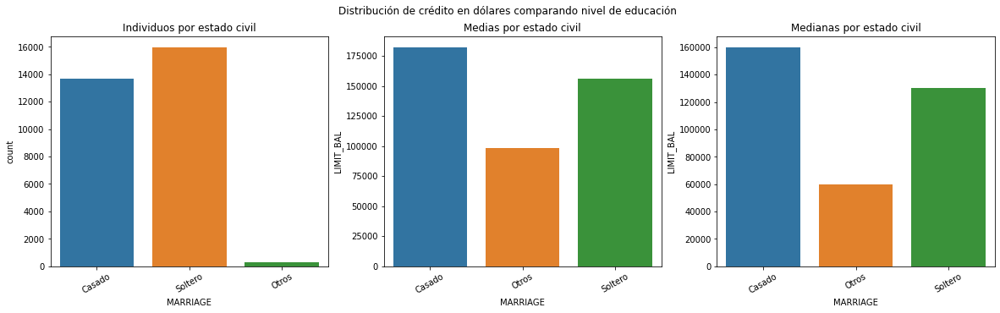

In [30]:
fig, axes = plt.subplots(1, 3, figsize=(20, 5))
fig.suptitle('Distribución de crédito en dólares comparando nivel de educación')

sns.barplot(x="MARRIAGE", y="LIMIT_BAL", data=mean_by_marriage, ax = axes[1])
axes[1].set_title("Medias por estado civil")
axes[1].set_xticklabels(axes[1].get_xticklabels(),rotation = 30)

sns.barplot(x="MARRIAGE", y="LIMIT_BAL", data=median_by_marriage, ax = axes[2])
axes[2].set_title("Medianas por estado civil")
axes[2].set_xticklabels(axes[2].get_xticklabels(),rotation = 30)

sns.countplot(x="MARRIAGE", data=df, ax = axes[0])
axes[0].set_title("Individuos por estado civil")
axes[0].set_xticklabels(axes[0].get_xticklabels(),rotation = 30)

Aca se puede observar mejor los resultados anteriormente discutidos

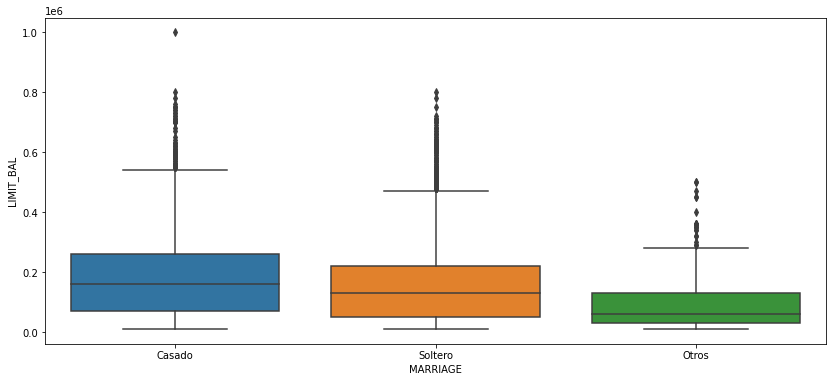

In [31]:
fig_dims = (14, 6)
fig, ax = plt.subplots(figsize=fig_dims)
sns.boxplot(data= df, x="MARRIAGE", y = "LIMIT_BAL", ax = ax)

### Análisis por grupo de edad

In [32]:
df[["AGE_LABEL","LIMIT_BAL"]].groupby("AGE_LABEL").agg(["mean","count","median"])

LIMIT_BAL                 
                        mean  count    median
AGE_LABEL                                    
Joven          132490.692818  11013  100000.0
Adulto joven   197271.539251  10713  180000.0
Adulto         179680.213156   6005  150000.0
Adulto Maduro  160300.518135   1930  110000.0
Edad Avanzada  185382.165605    314  160000.0
Mayor 70+      218800.000000     25  200000.0

In [33]:
mean_by_age = df[["AGE_LABEL","LIMIT_BAL"]].groupby("AGE_LABEL").agg("mean")
mean_by_age.reset_index(inplace = True)

median_by_age = df[["AGE_LABEL","LIMIT_BAL"]].groupby("AGE_LABEL").agg("median")
median_by_age.reset_index(inplace = True)

Los grupos de personas que se encuentran de 60 años para arriba se encuentran menos representados en comparación a los otros grupos, esto de alguna manera es explicable dado que es díficil que una persona a esa edad pueda pagar en un período de tiempo relativamente corto. Por otro lado las personas que se encuentran entre los 30 y 50 años son las personas que piden créditos más grandes, de acuerdos a sus medias, medianas y el boxplot que se encuentra más bajo.

[Text(0, 0, 'Joven'),
 Text(0, 0, 'Adulto joven'),
 Text(0, 0, 'Adulto'),
 Text(0, 0, 'Adulto Maduro'),
 Text(0, 0, 'Edad Avanzada'),
 Text(0, 0, 'Mayor 70+')]

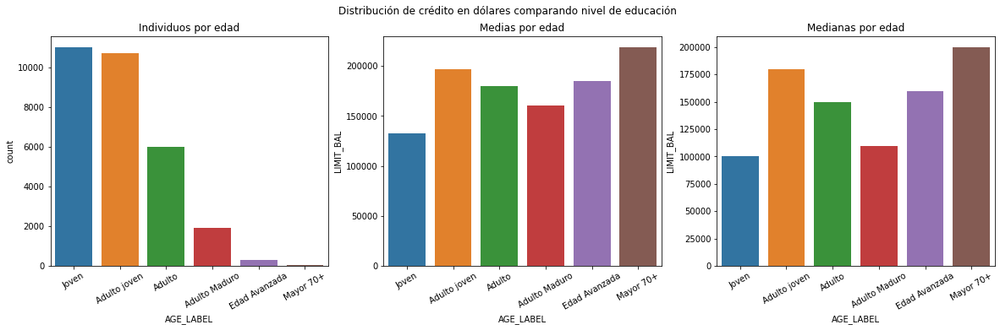

In [34]:
fig, axes = plt.subplots(1, 3, figsize=(20, 5))
fig.suptitle('Distribución de crédito en dólares comparando nivel de educación')

sns.barplot(x="AGE_LABEL", y="LIMIT_BAL", data=mean_by_age, ax = axes[1])
axes[1].set_title("Medias por edad")
axes[1].set_xticklabels(axes[1].get_xticklabels(),rotation = 30)

sns.barplot(x="AGE_LABEL", y="LIMIT_BAL", data=median_by_age, ax = axes[2])
axes[2].set_title("Medianas por edad")
axes[2].set_xticklabels(axes[2].get_xticklabels(),rotation = 30)

sns.countplot(x="AGE_LABEL", data=df, ax = axes[0])
axes[0].set_title("Individuos por edad")
axes[0].set_xticklabels(axes[0].get_xticklabels(),rotation = 30)

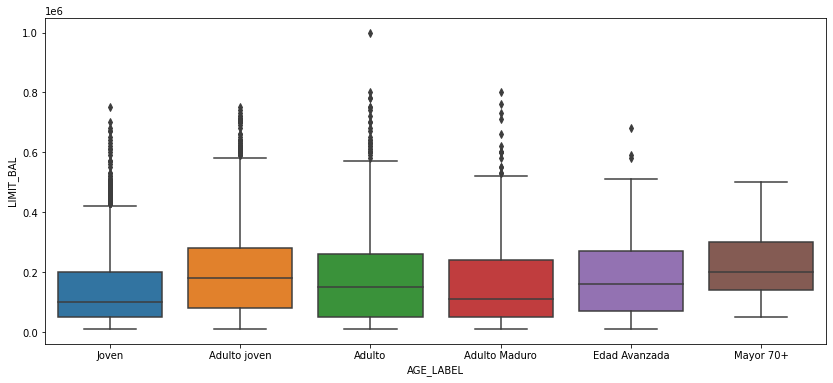

In [35]:
fig_dims = (14, 6)
fig, ax = plt.subplots(figsize=fig_dims)
sns.boxplot(data= df, x="AGE_LABEL", y = "LIMIT_BAL", ax = ax)

### Análisis de retrasos


Este es un análisis de los retrasos de acuerdo a los meses. 

In [36]:
retrasos_abr = df['PAY_6']
retrasos_may = df['PAY_5']
retrasos_jun = df['PAY_4']
retrasos_jul = df['PAY_3']
retrasos_ago = df['PAY_2']
retrasos_sep = df['PAY_0']

In [37]:
retrasos = [retrasos_abr[retrasos_abr != "Solvente"].count(),
            retrasos_may[retrasos_may != "Solvente"].count(),
            retrasos_jun[retrasos_jun != "Solvente"].count(),
            retrasos_jul[retrasos_jul != "Solvente"].count(),
            retrasos_ago[retrasos_ago != "Solvente"].count(),
            retrasos_sep[retrasos_sep != "Solvente"].count(),
            ]
solventes = [retrasos_abr[retrasos_abr == "Solvente"].count(),
            retrasos_may[retrasos_may == "Solvente"].count(),
            retrasos_jun[retrasos_jun == "Solvente"].count(),
            retrasos_jul[retrasos_jul == "Solvente"].count(),
            retrasos_ago[retrasos_ago == "Solvente"].count(),
            retrasos_sep[retrasos_sep == "Solvente"].count(),
            ]
meses = ["Abril","Mayo","Junio","Julio","Agosto","Septiembre"]

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


[Text(0, 0, 'Abril'),
 Text(0, 0, 'Mayo'),
 Text(0, 0, 'Junio'),
 Text(0, 0, 'Julio'),
 Text(0, 0, 'Agosto'),
 Text(0, 0, 'Septiembre')]

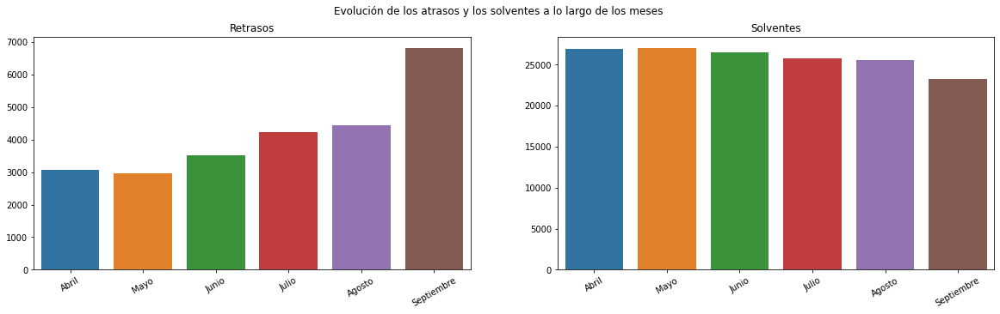

In [38]:
fig, axes = plt.subplots(1, 2, figsize=(20, 5))
fig.suptitle('Evolución de los atrasos y los solventes a lo largo de los meses')

sns.barplot(meses, retrasos, ax = axes[0])
axes[0].set_title("Retrasos")
axes[0].set_xticklabels(axes[0].get_xticklabels(),rotation = 30)

sns.barplot(meses, solventes, ax = axes[1])
axes[1].set_title("Solventes")
axes[1].set_xticklabels(axes[1].get_xticklabels(),rotation = 30)

Es interesante notar en la gráfica de arriba que la cantidad de personas solventes se ha mantenido de forma similar a lo largo de los meses, sin embargo el número de personas insolventes ha ido en aumento

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-package

[Text(0, 0, 'Retraso 1-3 meses'),
 Text(0, 0, 'Solvente'),
 Text(0, 0, 'Retraso 4-6 meses'),
 Text(0, 0, 'Retraso 7+ meses')]

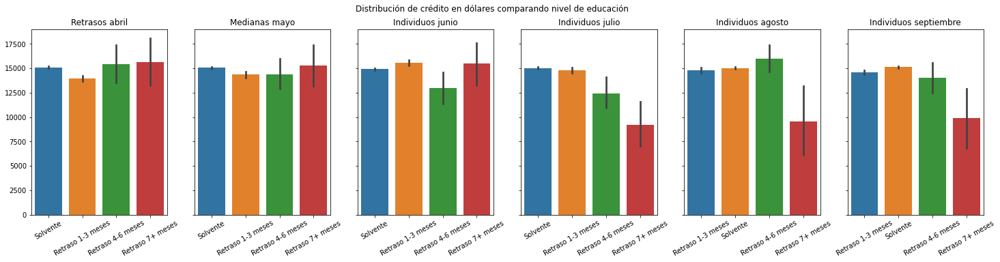

In [39]:
fig, axes = plt.subplots(1, 6, figsize=(25, 5), sharey=True)
fig.suptitle('Distribución de crédito en dólares comparando nivel de educación')

sns.barplot(retrasos_abr.values, retrasos_abr.index, ax = axes[0])
axes[0].set_title("Retrasos abril")
axes[0].set_xticklabels(axes[0].get_xticklabels(),rotation = 30)

sns.barplot(retrasos_may.values, retrasos_may.index, ax = axes[1])
axes[1].set_title("Medianas mayo")
axes[1].set_xticklabels(axes[1].get_xticklabels(),rotation = 30)

sns.barplot(retrasos_jun.values, retrasos_jun.index, ax = axes[2])
axes[2].set_title("Individuos junio")
axes[2].set_xticklabels(axes[2].get_xticklabels(),rotation = 30)

sns.barplot(retrasos_jul.values, retrasos_jul.index, ax = axes[3])
axes[3].set_title("Individuos julio")
axes[3].set_xticklabels(axes[3].get_xticklabels(),rotation = 30)

sns.barplot(retrasos_ago.values, retrasos_ago.index, ax = axes[4])
axes[4].set_title("Individuos agosto")
axes[4].set_xticklabels(axes[4].get_xticklabels(),rotation = 30)

sns.barplot(retrasos_sep.values, retrasos_sep.index, ax = axes[5])
axes[5].set_title("Individuos septiembre")
axes[5].set_xticklabels(axes[5].get_xticklabels(),rotation = 30)

En la gráfica de arriba se puede observar como a lo largo del tiempo las personas que están solventes, tienen un retraso de 2 meses o un retraso de 3 a 6 meses se mantienen de cierta manera casi igual, sin un cambio abrupto. Es interesante que en los primeros meses no existían personas que se atrasaran un mes pero en junio empezaron a aparecer y luego empiezan a crecer bastante. También es interesante notar como ha ido disminuyendo el número de personas que se atrasaron más de 7 meses empezaron a disminuir a partir de junio. Lo que nos puede decir que hubo algún cambio importante a la hora de dar créditos. 
<br>
<br>
Viendo estas dos gráficas se puede decir que el número de personas insolventes ha ido en aumento pero por un periodo de tiempo corto lo cual puede ser negativo y positivo al mismo tiempo, porque también hay que notar que las personas que tienen un retraso superior a 7 meses a ido disminuyendo

### Análisis del monto de factura 

In [73]:
monto_facturacion = df[["BILL_AMT6","BILL_AMT5","BILL_AMT4","BILL_AMT3","BILL_AMT2","BILL_AMT1"]]
monto_facturacion.describe()

,BILL_AMT6,BILL_AMT5,BILL_AMT4,BILL_AMT3,BILL_AMT2,BILL_AMT1
count,30000.000000,30000.000000,30000.000000,3.000000e+04,30000.000000,30000.000000
mean,38871.760400,40311.400967,43262.948967,4.701315e+04,49179.075167,51223.330900
std,59554.107537,60797.155770,64332.856134,6.934939e+04,71173.768783,73635.860576
min,-339603.000000,-81334.000000,-170000.000000,-1.572640e+05,-69777.000000,-165580.000000
25%,1256.000000,1763.000000,2326.750000,2.666250e+03,2984.750000,3558.750000
50%,17071.000000,18104.500000,19052.000000,2.008850e+04,21200.000000,22381.500000
75%,49198.250000,50190.500000,54506.000000,6.016475e+04,64006.250000,67091.000000
max,961664.000000,927171.000000,891586.000000,1.664089e+06,983931.000000,964511.000000


Text(0.5, 1.0, 'Monto de facturación promedio de acuerdo a los meses')

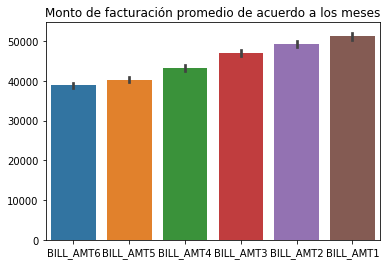

In [81]:
sns.barplot(data=monto_facturacion)
plt.title("Monto de facturación promedio de acuerdo a los meses")

Text(0.5, 1.0, 'Monto de facturación promedio de acuerdo a los meses')

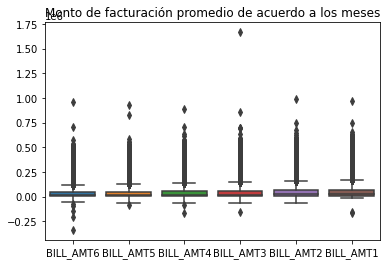

In [82]:
sns.boxplot(data=monto_facturacion)
plt.title("Monto de facturación promedio de acuerdo a los meses")

El monto de facturación mensual va creciendo conforme a los meses; sin embargo, nótese que las cajas de bigotes reflejan muchos datos atípicos; por lo que no es uniforme el monto de facturación y varía demasiado. 

### Análisis del monto de pago

In [79]:
monto_pago = df[["PAY_AMT6","PAY_AMT5","PAY_AMT4","PAY_AMT3","PAY_AMT2","PAY_AMT1"]]
monto_pago.describe()

,PAY_AMT6,PAY_AMT5,PAY_AMT4,PAY_AMT3,PAY_AMT2,PAY_AMT1
count,30000.000000,30000.000000,30000.000000,30000.00000,3.000000e+04,30000.000000
mean,5215.502567,4799.387633,4826.076867,5225.68150,5.921163e+03,5663.580500
std,17777.465775,15278.305679,15666.159744,17606.96147,2.304087e+04,16563.280354
min,0.000000,0.000000,0.000000,0.00000,0.000000e+00,0.000000
25%,117.750000,252.500000,296.000000,390.00000,8.330000e+02,1000.000000
50%,1500.000000,1500.000000,1500.000000,1800.00000,2.009000e+03,2100.000000
75%,4000.000000,4031.500000,4013.250000,4505.00000,5.000000e+03,5006.000000
max,528666.000000,426529.000000,621000.000000,896040.00000,1.684259e+06,873552.000000


Text(0.5, 1.0, 'Monto de facturación promedio de acuerdo a los meses')

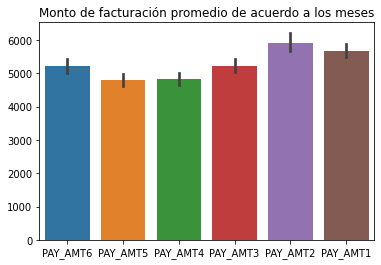

In [83]:
sns.barplot(data=monto_pago)
plt.title("Monto de facturación promedio de acuerdo a los meses")

Text(0.5, 1.0, 'Monto de facturación promedio de acuerdo a los meses')

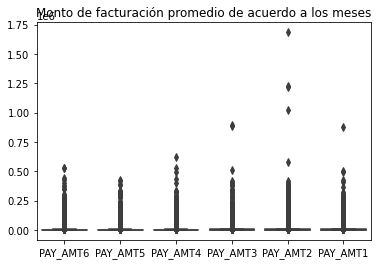

In [84]:
sns.boxplot(data=monto_pago)
plt.title("Monto de facturación promedio de acuerdo a los meses")

El monto de pago mensual no tiene ninguna tendencia aparente; sin embargo, nótese que las cajas de bigotes reflejan muchos datos atípicos; por lo que no es uniforme el monto de pago y varía demasiado. 

## Cruzando variables


### SEX vs EDUCATION


In [40]:
table = pd.pivot_table(df, values='LIMIT_BAL', index=['SEX'],
                    columns=['EDUCATION'], aggfunc='count', margins = True)
table.round(2) / 30000

EDUCATION,Bachillerato,Desconocido 1,Desconocido 2,Desconocidos 3,Otros,Postgrado,Universidad,All
SEX,,,,,,,,
Femenino,0.097567,0.000200,0.006167,0.000867,0.0027,0.207700,0.288533,0.603733
Masculino,0.066333,0.000267,0.003167,0.000833,0.0014,0.145133,0.179133,0.396267
All,0.163900,0.000467,0.009333,0.001700,0.0041,0.352833,0.467667,1.000000


In [41]:
table = pd.pivot_table(df, values='LIMIT_BAL', index=['SEX'],
                    columns=['EDUCATION'], aggfunc=np.mean)
table.round(2)

EDUCATION,Bachillerato,Desconocido 1,Desconocido 2,Desconocidos 3,Otros,Postgrado,Universidad
SEX,,,,,,,
Femenino,130362.15,223333.33,172756.76,139615.38,233209.88,208557.21,155232.90
Masculino,120943.56,212500.00,159221.05,157200.00,197142.86,219251.26,133902.12


En el primer dataframe de la seciión se puede notar que los grupos mejor represntados son aquellos que tienen estudios de post o universidad, además de ser las mujeres las que tienen mayor presencia como ya se había visto previamente.
<br>
En cuanto a las medias más altas de créditos se puede observar que las personas con estudios de postgrado, otros o desconocido 1 son las personas con mayores medias indpendientemente del sexo

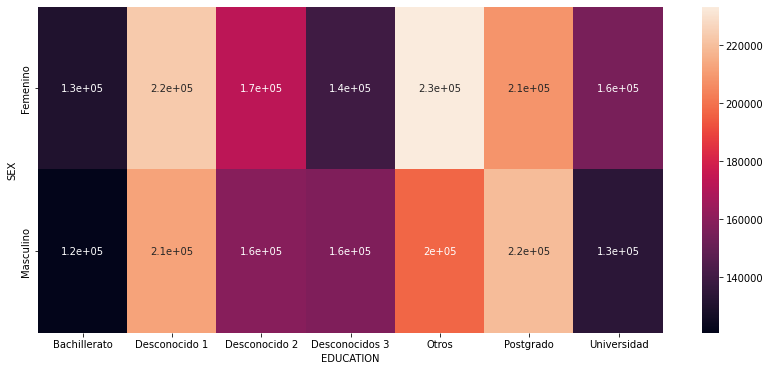

In [42]:
fig_dims = (14, 6)
fig, ax = plt.subplots(figsize=fig_dims)
sns.heatmap(table, ax = ax, annot = True)

### MARRIAGE vs EDUCATION

In [43]:
table = pd.pivot_table(df, values='LIMIT_BAL', index=['EDUCATION'],
                    columns=['MARRIAGE'], aggfunc='count', margins = True)
table.round(2) / 29946

MARRIAGE,Casado,Otros,Soltero,All
EDUCATION,,,,
Bachillerato,0.095539,0.003440,0.063748,0.162726
Desconocido 1,0.000134,NaN,0.000334,0.000468
Desconocido 2,0.005009,0.000100,0.004241,0.009350
Desconocidos 3,0.000935,0.000067,0.000701,0.001703
Otros,0.001736,0.000100,0.002271,0.004107
Postgrado,0.124290,0.001670,0.227376,0.353336
Universidad,0.228478,0.005410,0.234422,0.468310
All,0.456121,0.010786,0.533093,1.000000


In [44]:
table = pd.pivot_table(df, values='LIMIT_BAL', index=['EDUCATION'],
                    columns=['MARRIAGE'], aggfunc='mean')
table.round(2)

MARRIAGE,Casado,Otros,Soltero
EDUCATION,,,
Bachillerato,133327.51,74951.46,119364.94
Desconocido 1,170000.00,NaN,236000.00
Desconocido 2,193506.67,106666.67,139685.04
Desconocidos 3,159642.86,185000.00,129523.81
Otros,241730.77,206666.67,205588.24
Postgrado,253113.92,172800.00,191310.03
Universidad,163460.39,86481.48,132434.47


En cuanto a las proporciones del dataset nuevamente son las personas de universidad de postgrado y universidad las mejor representadas, además de notar que los casados y los solteros de estos grupos son bastante similares.
<br>
Las personas que estudian en postgrado u otros estudios y están casados tienden a tener una media bastante alta respecto a sus créditos. Del lado de los solteros se puede ver que los que pertencen al grupo de estudios Desconocido 1 y Otros también tienen medias bastante altas.


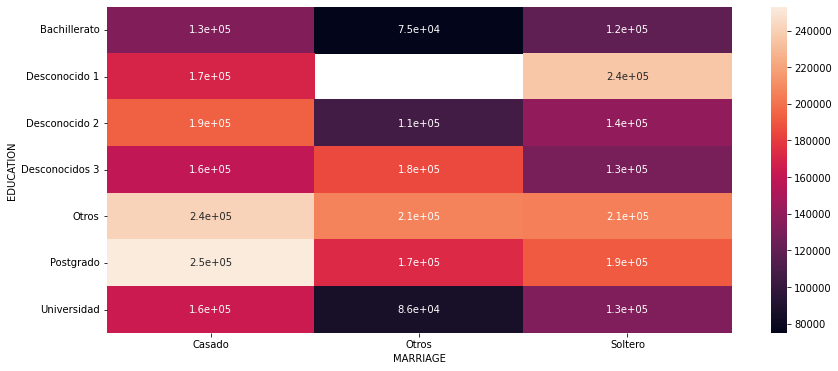

In [45]:
fig_dims = (14, 6)
fig, ax = plt.subplots(figsize=fig_dims)
sns.heatmap(table, ax = ax, annot = True)

### AGE vs EDUCATION

In [46]:
table = pd.pivot_table(df, values='LIMIT_BAL', index=['EDUCATION'],
                    columns=['AGE_LABEL'], aggfunc='count', margins = True)
table.round(2)/ 30000

AGE_LABEL,Joven,Adulto joven,Adulto,Adulto Maduro,Edad Avanzada,Mayor 70+,All
EDUCATION,,,,,,,
Bachillerato,0.036033,0.046000,0.051967,0.025233,0.004267,0.000400,0.163900
Desconocido 1,0.000100,0.000233,0.000100,0.000033,NaN,NaN,0.000467
Desconocido 2,0.003067,0.003733,0.001900,0.000567,0.000067,NaN,0.009333
Desconocidos 3,0.000233,0.000267,0.000800,0.000333,0.000067,NaN,0.001700
Otros,0.001933,0.001233,0.000767,0.000167,NaN,NaN,0.004100
Postgrado,0.143467,0.137833,0.053400,0.015067,0.002800,0.000267,0.352833
Universidad,0.182267,0.167800,0.091233,0.022933,0.003267,0.000167,0.467667
All,0.367100,0.357100,0.200167,0.064333,0.010467,0.000833,1.000000


In [47]:
table = pd.pivot_table(df, values='LIMIT_BAL', index=['EDUCATION'],
                    columns=['AGE_LABEL'], aggfunc='mean')
table.round(2)

AGE_LABEL,Joven,Adulto joven,Adulto,Adulto Maduro,Edad Avanzada,Mayor 70+
EDUCATION,,,,,,
Bachillerato,101285.85,148985.51,128016.47,116446.50,134687.50,182500.0
Desconocido 1,236666.67,197142.86,200000.00,350000.00,NaN,NaN
Desconocido 2,125652.17,187767.86,188877.19,191764.71,235000.00,NaN
Desconocidos 3,90000.00,162500.00,161666.67,119000.00,280000.00,NaN
Otros,174482.76,279459.46,230000.00,284000.00,NaN,NaN
Postgrado,159107.81,245782.35,257790.26,255176.99,270357.14,250000.0
Universidad,117375.64,170323.80,162910.49,144869.19,175816.33,256000.0


En la gráfica de abajo se puede observar que los adultos entre 50 y 60 años cuyo grado academico es Desconocido 1, tiene una media bastante eleveada respecto al resto llegando a los 350 mil dólares. También llama la atención que las personas que tienen un postgrado y tienen más de 30 años tienen medias de crédito bastante altas

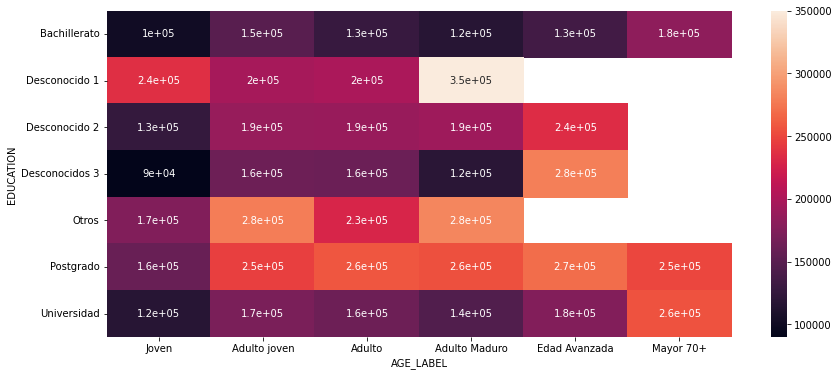

In [48]:
fig_dims = (14, 6)
fig, ax = plt.subplots(figsize=fig_dims)
sns.heatmap(table, ax = ax, annot = True)

### SEX vs AGE


In [90]:
table = pd.pivot_table(df, values='LIMIT_BAL', index=['SEX'],
                    columns=['AGE_LABEL'], aggfunc='count', margins = True)
table.round(2) / 30000

AGE_LABEL,Joven,Adulto joven,Adulto,Adulto Maduro,Edad Avanzada,Mayor 70+,All
SEX,,,,,,,
Femenino,0.239033,0.211667,0.113933,0.033767,0.004933,0.000400,0.603733
Masculino,0.128067,0.145433,0.086233,0.030567,0.005533,0.000433,0.396267
All,0.367100,0.357100,0.200167,0.064333,0.010467,0.000833,1.000000


In [91]:
table = pd.pivot_table(df, values='LIMIT_BAL', index=['SEX'],
                    columns=['AGE_LABEL'], aggfunc='mean')
table.round(2)

AGE_LABEL,Joven,Adulto joven,Adulto,Adulto Maduro,Edad Avanzada,Mayor 70+
SEX,,,,,,
Femenino,139241.39,201929.13,180604.45,154639.68,157702.70,213333.33
Masculino,119890.68,190492.78,178459.10,166553.98,210060.24,223846.15


La corelación entre joven y sexo parece ser fuerte de sobremanera en un LIMIT_BAL bajo. 

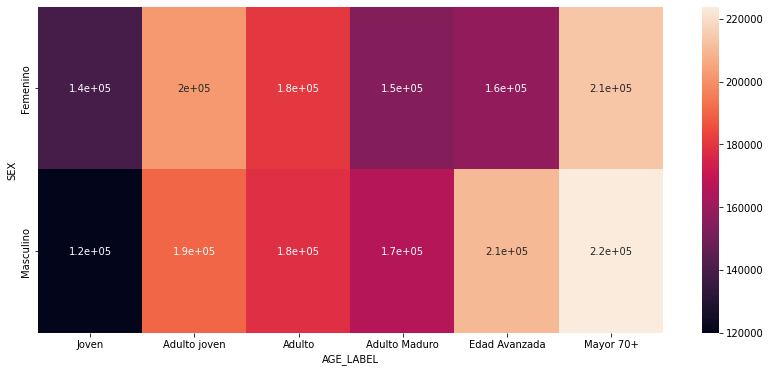

In [92]:
fig_dims = (14, 6)
fig, ax = plt.subplots(figsize=fig_dims)
sns.heatmap(table, ax = ax, annot = True)

### AGE vs MARRIAGE 

In [94]:
table = pd.pivot_table(df, values='LIMIT_BAL', index=['AGE_LABEL'],
                    columns=['MARRIAGE'], aggfunc='count', margins = True)
table.round(2) / 30000

MARRIAGE,Casado,Otros,Soltero,All
AGE_LABEL,,,,
Joven,0.062700,0.001467,0.302533,0.366700
Adulto joven,0.190733,0.002633,0.163000,0.356367
Adulto,0.145400,0.004200,0.050067,0.199667
Adulto Maduro,0.047233,0.002233,0.014700,0.064167
Edad Avanzada,0.008467,0.000233,0.001767,0.010467
Mayor 70+,0.000767,NaN,0.000067,0.000833
All,0.455300,0.010767,0.532133,0.998200


In [95]:
table = pd.pivot_table(df, values='LIMIT_BAL', index=['AGE_LABEL'],
                    columns=['MARRIAGE'], aggfunc='mean')
table.round(2)

MARRIAGE,Casado,Otros,Soltero
AGE_LABEL,,,
Joven,133136.63,90454.55,132594.76
Adulto joven,195082.14,134050.63,201112.47
Adulto,188448.42,86746.03,162561.70
Adulto Maduro,172709.95,83731.34,131723.36
Edad Avanzada,196968.50,81428.57,143584.91
Mayor 70+,226956.52,NaN,125000.00



La corelación entre otros y cualquier edad tiene tendencia baja. 

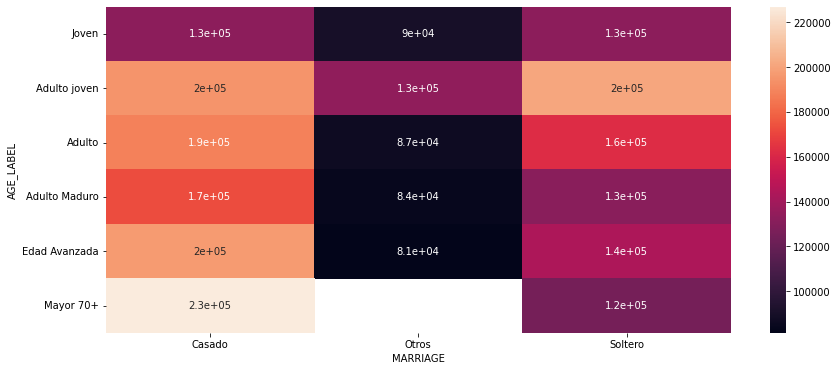

In [96]:
fig_dims = (14, 6)
fig, ax = plt.subplots(figsize=fig_dims)
sns.heatmap(table, ax = ax, annot = True)

### SEX vs MARRIAGE

In [97]:
table = pd.pivot_table(df, values='LIMIT_BAL', index=['SEX'],
                    columns=['MARRIAGE'], aggfunc='count', margins = True)
table.round(2) / 30000

MARRIAGE,Casado,Otros,Soltero,All
SEX,,,,
Femenino,0.2823,0.006400,0.313700,0.6024
Masculino,0.1730,0.004367,0.218433,0.3958
All,0.4553,0.010767,0.532133,0.9982


In [98]:
table = pd.pivot_table(df, values='LIMIT_BAL', index=['SEX'],
                    columns=['MARRIAGE'], aggfunc='mean')
table.round(2)

MARRIAGE,Casado,Otros,Soltero
SEX,,,
Femenino,176772.46,101614.58,165620.02
Masculino,191058.96,92900.76,143192.08


Otros y cualquier sexo tiene correlación dominante baja. 


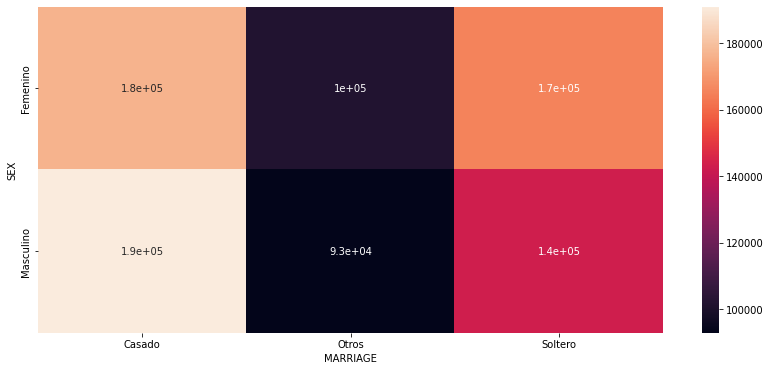

In [99]:
fig_dims = (14, 6)
fig, ax = plt.subplots(figsize=fig_dims)
sns.heatmap(table, ax = ax, annot = True)